In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.io as pio
pio.renderers.default = "notebook_connected"
df = pd.read_csv('cleaned_india_housing_prices.csv')

In [3]:
df.head()

,id,state,city,locality,property_type,bhk,size_in_sqft,price_in_lakhs,price_per_sqft,year_built,...,age_of_property,nearby_schools,nearby_hospitals,public_transport_accessibility,parking_space,security,amenities,facing,owner_type,availability_status
0,1,Tamil Nadu,Chennai,Locality_84,Apartment,1,4740,489.76,10332.489451,1990,...,35,10,3,High,No,No,"Playground, Gym, Garden, Pool, Clubhouse",West,Owner,Ready_to_Move
1,2,Maharashtra,Pune,Locality_490,Independent House,3,2364,195.52,8270.727580,2008,...,17,8,1,Low,No,Yes,"Playground, Clubhouse, Pool, Gym, Garden",North,Builder,Under_Construction
2,3,Punjab,Ludhiana,Locality_167,Apartment,2,3642,183.79,5046.403075,1997,...,28,9,8,Low,Yes,No,"Clubhouse, Pool, Playground, Gym",South,Broker,Ready_to_Move
3,4,Rajasthan,Jodhpur,Locality_393,Independent House,2,2741,300.29,10955.490697,1991,...,34,5,7,High,Yes,Yes,"Playground, Clubhouse, Gym, Pool, Garden",North,Builder,Ready_to_Move
4,5,Rajasthan,Jaipur,Locality_466,Villa,4,4823,182.90,3792.245490,2002,...,23,4,9,Low,No,Yes,"Playground, Garden, Gym, Pool, Clubhouse",East,Builder,Ready_to_Move


Text(0.5, 0, 'Price (Lakhs)')

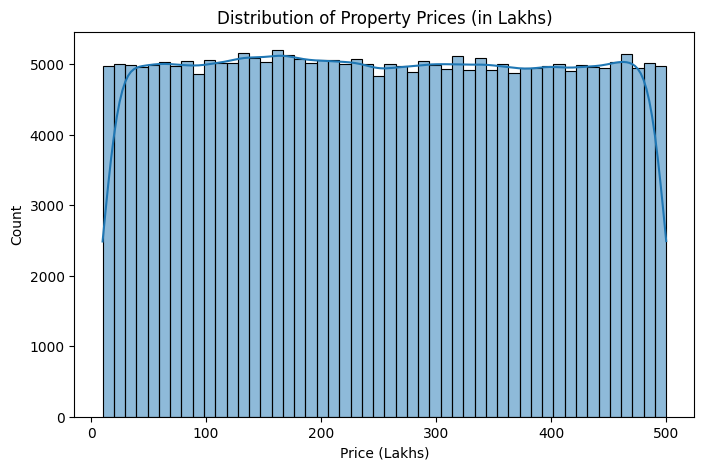

In [5]:
plt.figure(figsize=(8,5))
sns.histplot(df['price_in_lakhs'], bins=50, kde=True)
plt.title('Distribution of Property Prices (in Lakhs)')
plt.xlabel('Price (Lakhs)')

Text(0.5, 1.0, 'Distribution of Property Size (sqft)')

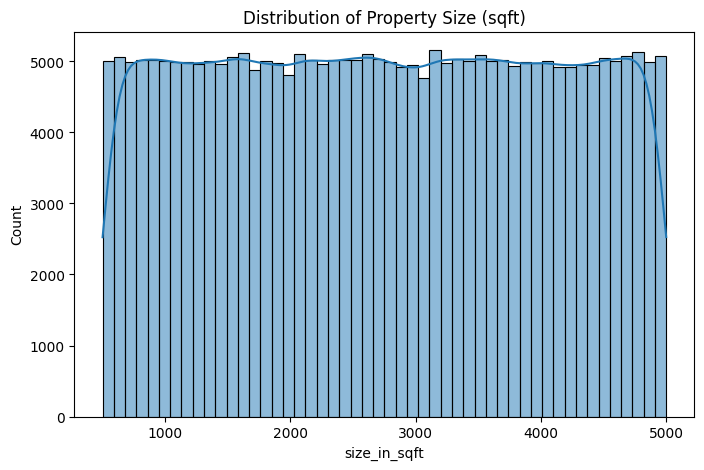

In [6]:
plt.figure(figsize=(8,5))
sns.histplot(df['size_in_sqft'], bins=50, kde=True)
plt.title('Distribution of Property Size (sqft)')

([0, 1, 2],
 [Text(0, 0, 'Apartment'),
  Text(1, 0, 'Independent House'),
  Text(2, 0, 'Villa')])

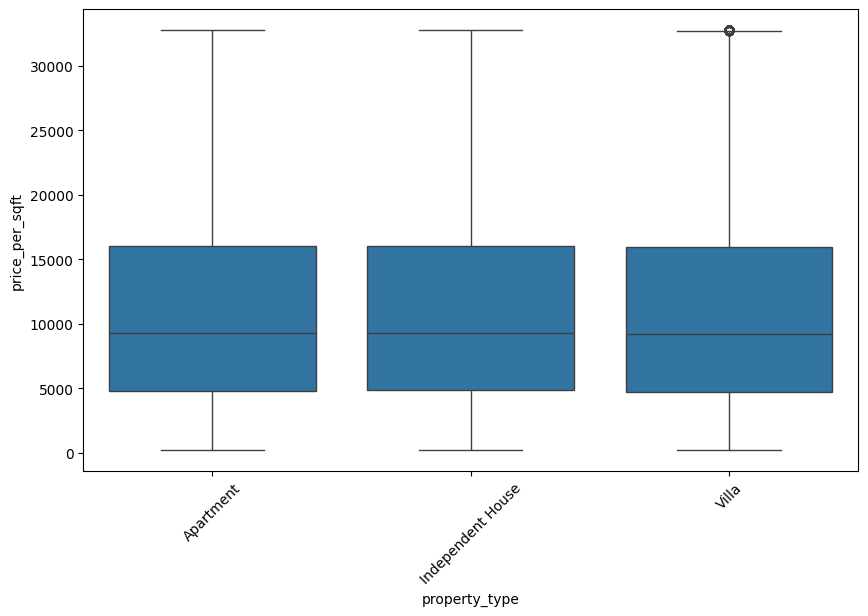

In [9]:
plt.figure(figsize=(10,6))
sns.boxplot(x='property_type', y='price_per_sqft', data=df)
plt.xticks(rotation=45)

In [11]:
fig = px.scatter(
    df,
    x='size_in_sqft',
    y='price_in_lakhs',
    color='city',
    hover_data=['locality', 'property_type']
)

fig.show()

In [13]:
state_avg = df.groupby('state')['price_per_sqft'].median().sort_values(ascending=False).reset_index()
px.bar(state_avg, x='state', y='price_per_sqft', title='Median Price per Sqft by State')

In [15]:
city_avg = df.groupby('city')['price_in_lakhs'].median().sort_values(ascending=False).head(20).reset_index()
px.bar(city_avg, x='city', y='price_in_lakhs', title='Top 20 Cities by Median Price')

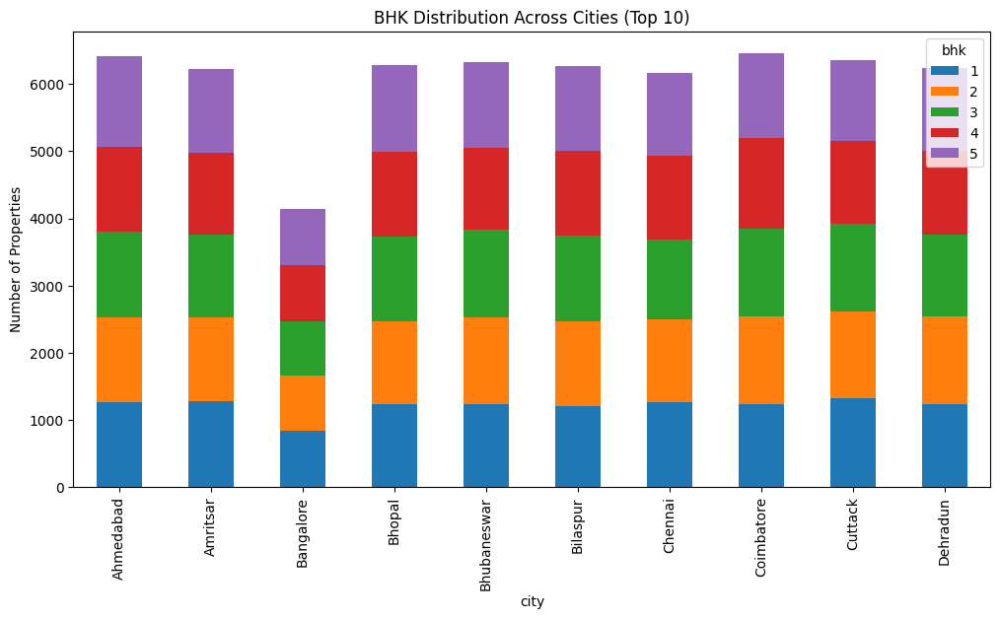

In [17]:
ct = pd.crosstab(df['city'], df['bhk'])
ct.iloc[:10,:].plot(kind='bar', stacked=True, figsize=(12,6))
plt.ylabel("Number of Properties")
plt.title("BHK Distribution Across Cities (Top 10)")
plt.show()

<Axes: >

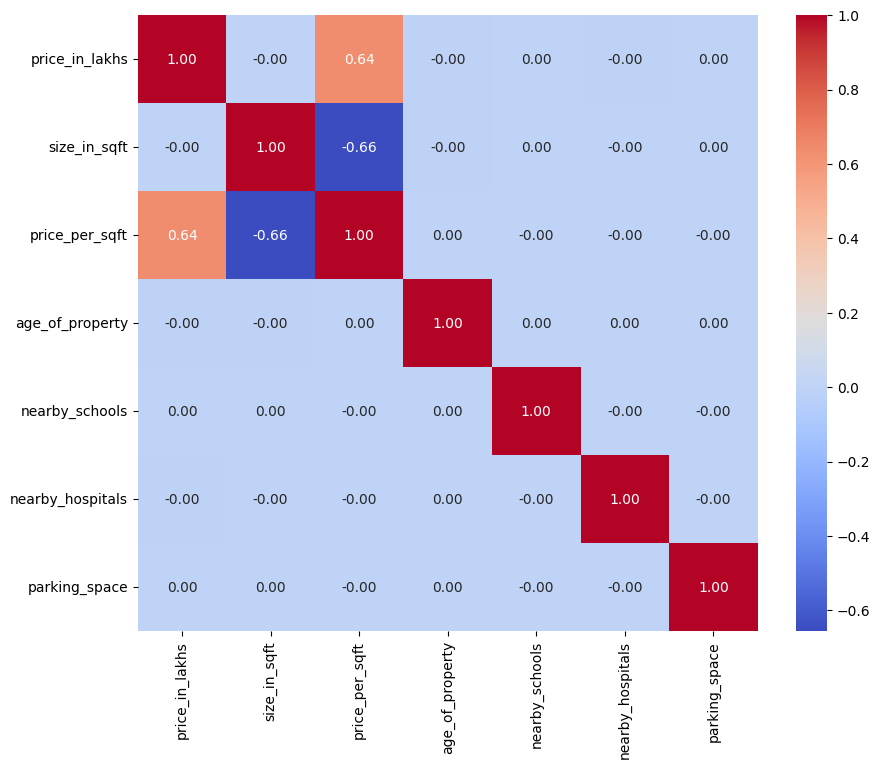

In [18]:
df['parking_space'] = df['parking_space'].str.strip().str.lower().map({'yes':1, 'no':0})

num_cols = ['price_in_lakhs','size_in_sqft','price_per_sqft','age_of_property','nearby_schools','nearby_hospitals','parking_space']
plt.figure(figsize=(10,8))
sns.heatmap(df[num_cols].corr(), annot=True, fmt='.2f', cmap='coolwarm')

In [20]:
px.box(df, x='furnished_status', y='price_per_sqft', title='Price per Sqft by Furnished Status')

In [23]:
count_data = df['owner_type'].value_counts().reset_index()
count_data.columns = ['owner_type', 'count']

fig = px.bar(
    count_data,
    x='owner_type',
    y='count',
    color='owner_type',   
    title='Distribution of Owner Types',
    labels={'count': 'Number of Properties', 'owner_type': 'Owner Type'},
    hover_data=['count']
)

fig.show()

In [25]:
avail_data = df['availability_status'].value_counts().reset_index()
avail_data.columns = ['availability_status', 'count']

fig = px.bar(
    avail_data,
    x='availability_status',
    y='count',
    color='availability_status',   
    title='Distribution of Availability Status',
    labels={'count': 'Number of Properties', 'availability_status': 'Availability Status'},
    hover_data=['count']
)

fig.show()

In [27]:
# convert amenities text to count
df['amenities_count'] = df['amenities'].apply(lambda x: len(str(x).split(',')) if pd.notna(x) else 0)
px.scatter(df, x='amenities_count', y='price_per_sqft', trendline='ols')